<a href="https://colab.research.google.com/github/dv66/split_audio/blob/main/simple_diarizer_youtube.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install torchaudio speechbrain youtube-dl pytube validators --quiet

In [ ]:
!git clone https://github.com/cvqluu/simple_diarizer.git

fatal: destination path 'simple_diarizer' already exists and is not an empty directory.


In [ ]:
from simple_diarizer.diarizer import Diarizer
from simple_diarizer.utils import (check_wav_16khz_mono, convert_wavfile, parse_ttml, 
                                   waveplot, combined_waveplot, waveplot_perspeaker, get_youtube_id, 
                                   download_youtube_wav, download_youtube_ttml)

import os
from pprint import pprint

import matplotlib.pyplot as plt
import numpy as np
import soundfile as sf

from IPython.display import Audio, display, HTML
from tqdm.autonotebook import tqdm

# Specify YouTube video/Upload your audio file here, and specify number of speakers



In [21]:
YOUTUBE_ID = "5mUXW6CuxuI"
WAV_FILE = "./{}_converted.wav".format(YOUTUBE_ID)
NUM_SPEAKERS = 2

In [22]:
HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/{}?rel=0&amp;controls=0&amp;showinfo=0" frameborder="0" allowfullscreen></iframe>'.format(YOUTUBE_ID))

### Download YouTube video audio

In [23]:
!youtube-dl --no-continue --extract-audio --audio-format wav -o "%(id)s.%(ext)s" $YOUTUBE_ID
!ffmpeg -y -i {YOUTUBE_ID}.wav -acodec pcm_s16le -ar 16000 -ac 1 $WAV_FILE

[youtube] 5mUXW6CuxuI: Downloading webpage
[download] Destination: 5mUXW6CuxuI.m4a
[download] 100% of 35.98MiB in 14:19
[ffmpeg] Correcting container in "5mUXW6CuxuI.m4a"
[ffmpeg] Destination: 5mUXW6CuxuI.wav
Deleting original file 5mUXW6CuxuI.m4a (pass -k to keep)
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-libr

## The full audio file preview:

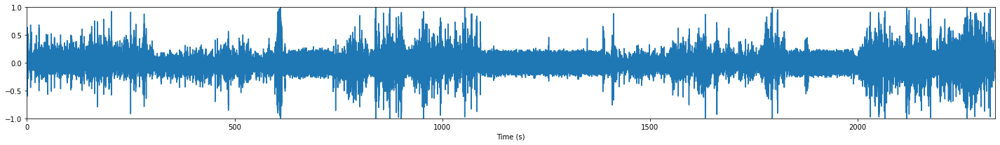

In [24]:
signal, fs = sf.read(WAV_FILE)
waveplot(signal, fs, figsize=(20,3))
plt.show()

# **Diarization**

## Run the model here:

### Make sure WAV_FILE is defined correctly here if deviating from the recipe

In [25]:
WAV_FILE = WAV_FILE # The location of the wav file
YOUTUBE_ID = YOUTUBE_ID # The id of the file we want to diarize

In [18]:
diar = Diarizer(
                embed_model='ecapa', # supported types: ['xvec', 'ecapa']
                cluster_method='sc', # supported types: ['ahc', 'sc']
                window=1.5, # size of window to extract embeddings (in seconds)
                period=0.75 # hop of window (in seconds)
                )

Using cache found in /root/.cache/torch/hub/snakers4_silero-vad_master


### If Num_speakers is known

In [27]:
segments = diar.diarize(WAV_FILE, 
                        num_speakers=3,
                        outfile='./{}.rttm'.format(YOUTUBE_ID))

Running VAD...
Splitting by silence found 446 utterances
Extracting embeddings...


Utterances:   0%|          | 0/446 [00:00<?, ?it/s]

Clustering to 3 speakers...


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:234: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


Cleaning up output...
Done!


### If num_speakers is unknown (use a threshold value)

In [ ]:
# segments = diar.diarize(WAV_FILE, 
#                         num_speakers=None,
#                         threshold=1e-1,
#                         outfile='./{}.rttm'.format(YOUTUBE_ID))

## Outputs

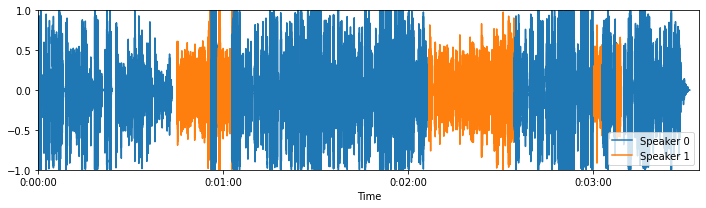

In [20]:
combined_waveplot(signal, fs, segments, figsize=(10,3), tick_interval=60)
plt.show()

### Segment outputs

In [ ]:
pprint(segments)

[{'end': 7.3259375,
  'end_sample': 117215,
  'label': 0,
  'start': 0.354,
  'start_sample': 5664},
 {'end': 8.5739375,
  'end_sample': 137183,
  'label': 0,
  'start': 7.584,
  'start_sample': 121344},
 {'end': 11.6459375,
  'end_sample': 186335,
  'label': 0,
  'start': 9.12,
  'start_sample': 145920},
 {'end': 13.4699375,
  'end_sample': 215519,
  'label': 0,
  'start': 11.904,
  'start_sample': 190464},
 {'end': 15.1019375,
  'end_sample': 241631,
  'label': 0,
  'start': 13.824,
  'start_sample': 221184},
 {'end': 17.0219375,
  'end_sample': 272351,
  'label': 0,
  'start': 15.36,
  'start_sample': 245760},
 {'end': 20.6699375,
  'end_sample': 330719,
  'label': 0,
  'start': 17.376,
  'start_sample': 278016},
 {'end': 26.9099375,
  'end_sample': 430559,
  'label': 0,
  'start': 21.6,
  'start_sample': 345600},
 {'end': 28.1579375,
  'end_sample': 450527,
  'label': 0,
  'start': 27.264,
  'start_sample': 436224},
 {'end': 57.8219375,
  'end_sample': 925151,
  'label': 0,
  'star

### RTTM file output

In [ ]:
!head {YOUTUBE_ID}.rttm

SPEAKER I49VNQ6lmKk_converted 0 0.354 6.9719375 <NA> <NA> 0 <NA> <NA>
SPEAKER I49VNQ6lmKk_converted 0 7.584 0.9899374999999999 <NA> <NA> 0 <NA> <NA>
SPEAKER I49VNQ6lmKk_converted 0 9.12 2.5259375000000013 <NA> <NA> 0 <NA> <NA>
SPEAKER I49VNQ6lmKk_converted 0 11.904 1.5659375000000004 <NA> <NA> 0 <NA> <NA>
SPEAKER I49VNQ6lmKk_converted 0 13.824 1.2779375000000002 <NA> <NA> 0 <NA> <NA>
SPEAKER I49VNQ6lmKk_converted 0 15.36 1.6619375000000005 <NA> <NA> 0 <NA> <NA>
SPEAKER I49VNQ6lmKk_converted 0 17.376 3.2939374999999984 <NA> <NA> 0 <NA> <NA>
SPEAKER I49VNQ6lmKk_converted 0 21.6 5.3099375 <NA> <NA> 0 <NA> <NA>
SPEAKER I49VNQ6lmKk_converted 0 27.264 0.8939374999999998 <NA> <NA> 0 <NA> <NA>
SPEAKER I49VNQ6lmKk_converted 0 28.704 29.117937499999996 <NA> <NA> 0 <NA> <NA>


## Playing individual per-speaker snippets

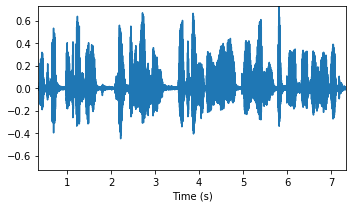

Speaker 0 (0.354s - 7.3259375s)


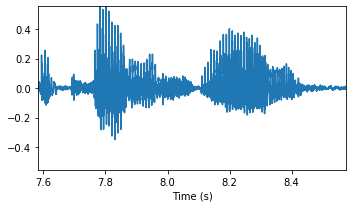

Speaker 0 (7.584s - 8.5739375s)


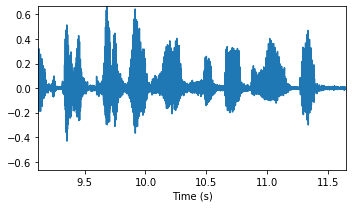

Speaker 0 (9.12s - 11.6459375s)


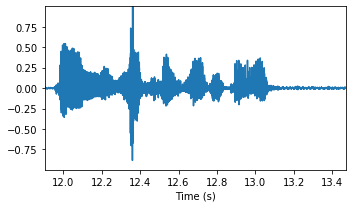

Speaker 0 (11.904s - 13.4699375s)


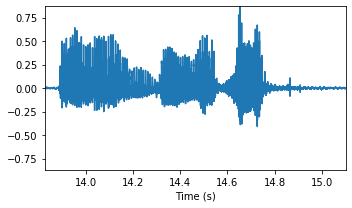

Speaker 0 (13.824s - 15.1019375s)


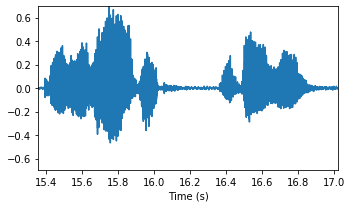

Speaker 0 (15.36s - 17.0219375s)


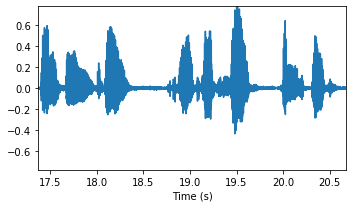

Speaker 0 (17.376s - 20.6699375s)


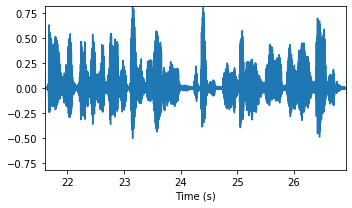

Speaker 0 (21.6s - 26.9099375s)


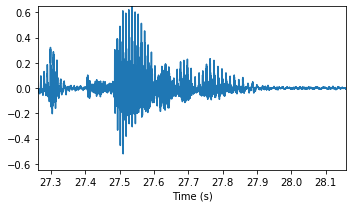

Speaker 0 (27.264s - 28.1579375s)


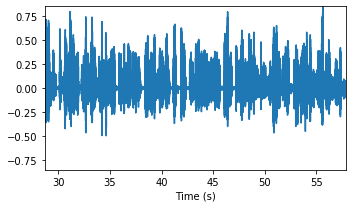

Speaker 0 (28.704s - 57.8219375s)


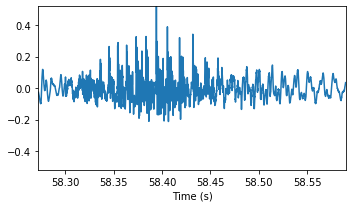

Speaker 0 (58.272s - 58.5899375s)


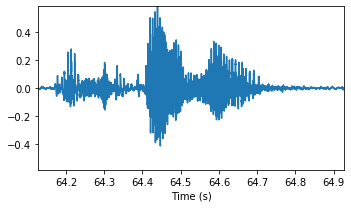

Speaker 0 (64.128s - 64.9259375s)


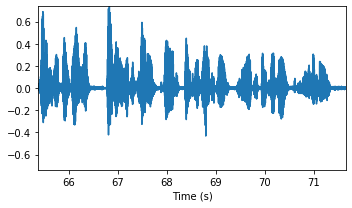

Speaker 0 (65.376s - 71.6459375s)


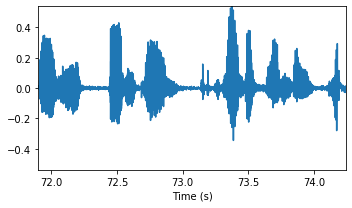

Speaker 0 (71.904s - 74.2379375s)


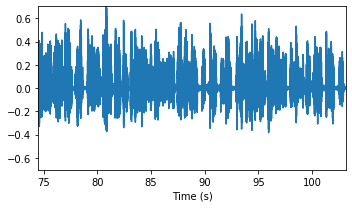

Speaker 0 (74.496s - 103.1339375s)


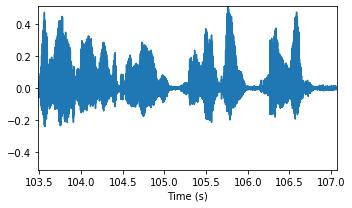

Speaker 0 (103.488s - 107.0699375s)


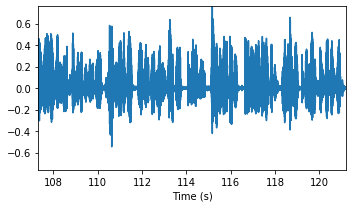

Speaker 0 (107.328s - 121.1819375s)


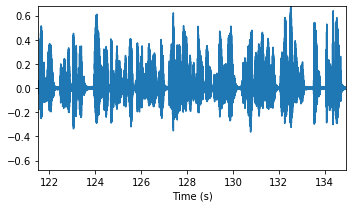

Speaker 0 (121.536s - 134.9099375s)


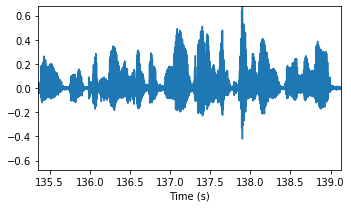

Speaker 0 (135.36s - 139.1339375s)


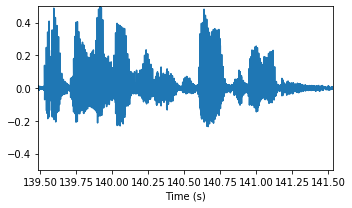

Speaker 0 (139.488s - 141.5339375s)


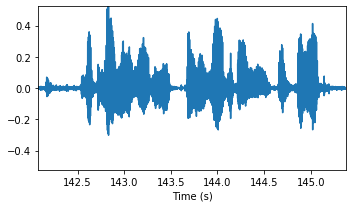

Speaker 0 (142.08s - 145.3739375s)


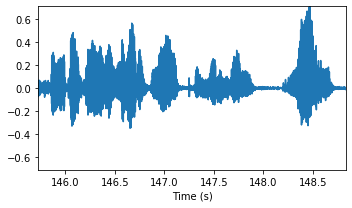

Speaker 0 (145.728s - 148.8299375s)


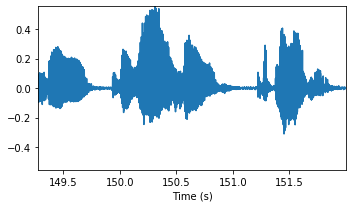

Speaker 0 (149.28s - 151.9979375s)


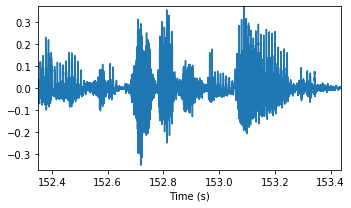

Speaker 0 (152.352s - 153.4379375s)


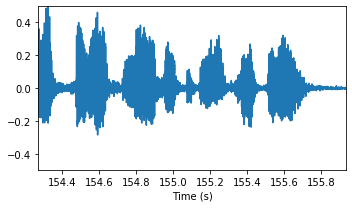

Speaker 0 (154.272s - 155.9339375s)


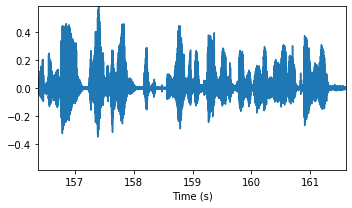

Speaker 0 (156.384s - 161.5979375s)


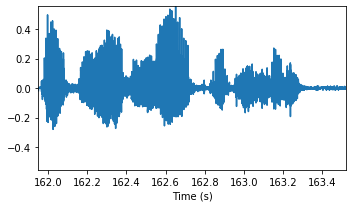

Speaker 0 (161.952s - 163.5179375s)


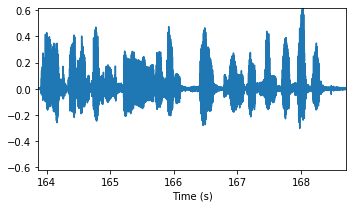

Speaker 0 (163.872s - 168.7019375s)


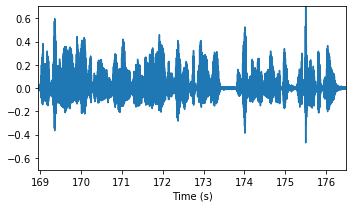

Speaker 0 (168.96s - 176.4779375s)


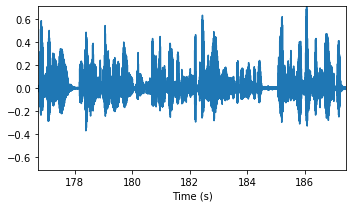

Speaker 0 (176.736s - 187.4219375s)


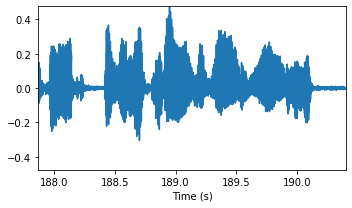

Speaker 0 (187.872s - 190.3979375s)


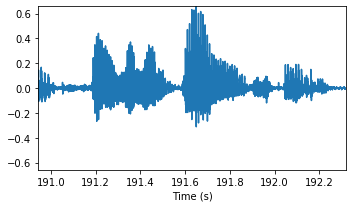

Speaker 0 (190.944s - 192.3179375s)


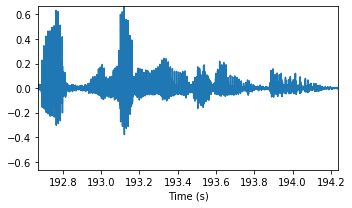

Speaker 0 (192.672s - 194.2379375s)


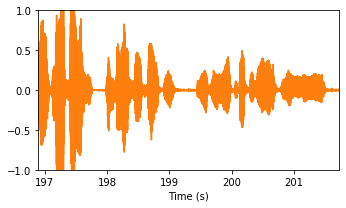

Speaker 1 (196.896s - 201.7259375s)


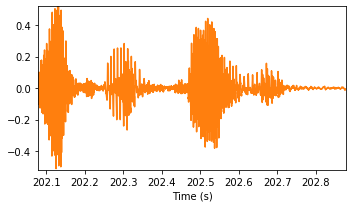

Speaker 1 (202.08s - 202.8779375s)


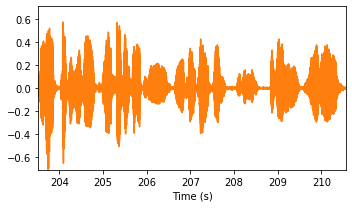

Speaker 1 (203.52s - 210.5579375s)


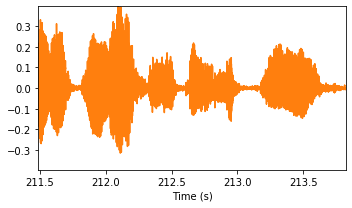

Speaker 1 (211.488s - 213.8219375s)


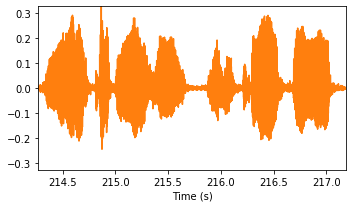

Speaker 1 (214.272s - 217.1819375s)


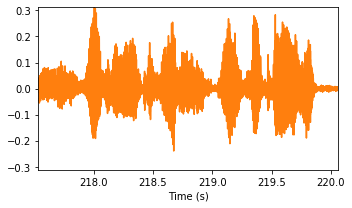

Speaker 1 (217.536s - 220.0619375s)


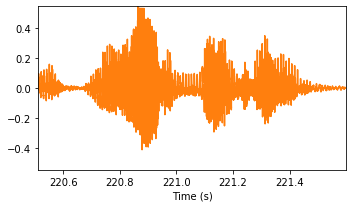

Speaker 1 (220.512s - 221.5979375s)


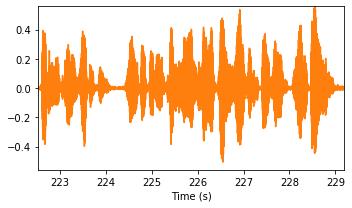

Speaker 1 (222.528s - 229.1819375s)


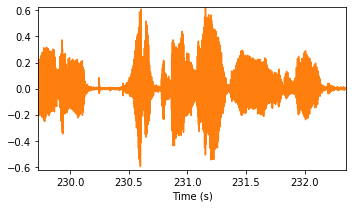

Speaker 1 (229.728s - 232.3499375s)


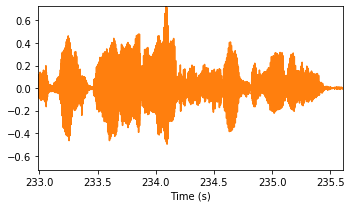

Speaker 1 (232.992s - 235.6139375s)


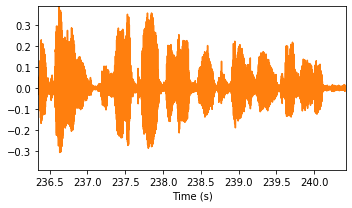

Speaker 1 (236.352s - 240.4139375s)


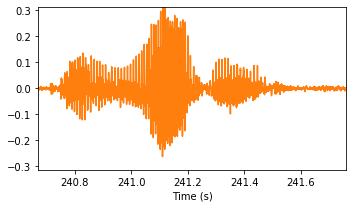

Speaker 1 (240.672s - 241.7579375s)


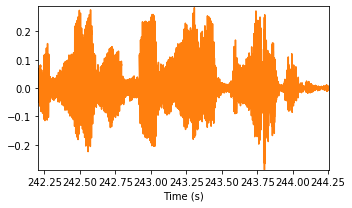

Speaker 1 (242.208s - 244.2539375s)


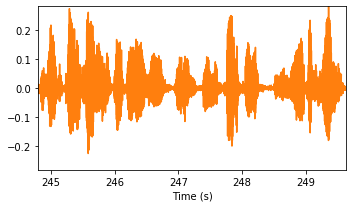

Speaker 1 (244.8s - 249.6299375s)


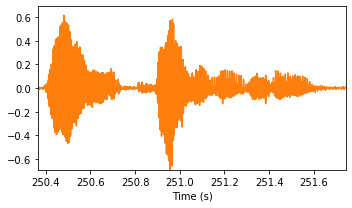

Speaker 1 (250.368s - 251.7419375s)


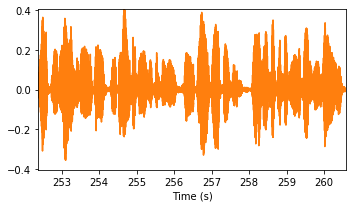

Speaker 1 (252.384s - 260.5739375s)


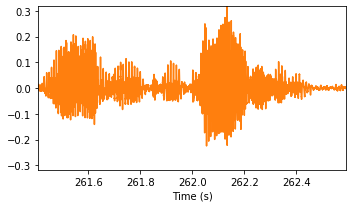

Speaker 1 (261.408s - 262.5899375s)


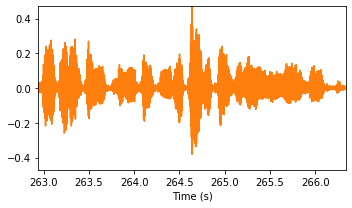

Speaker 1 (262.944s - 266.3339375s)


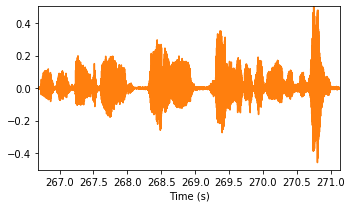

Speaker 1 (266.688s - 271.1339375s)


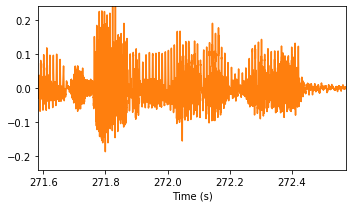

Speaker 1 (271.584s - 272.5739375s)


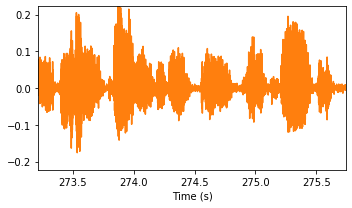

Speaker 1 (273.216s - 275.7419375s)


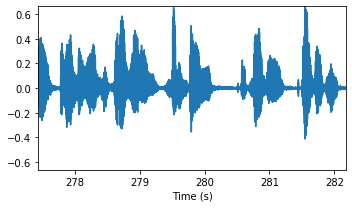

Speaker 0 (277.44s - 282.1739375s)


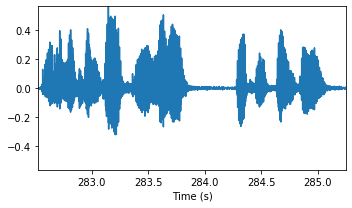

Speaker 0 (282.528s - 285.2459375s)


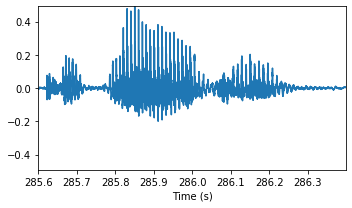

Speaker 0 (285.6s - 286.3979375s)


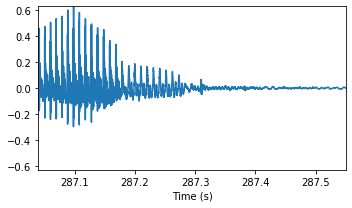

Speaker 0 (287.04s - 287.5499375s)


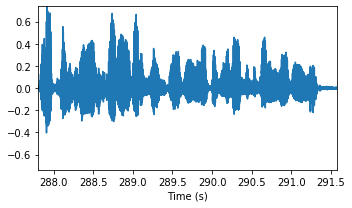

Speaker 0 (287.808s - 291.5819375s)


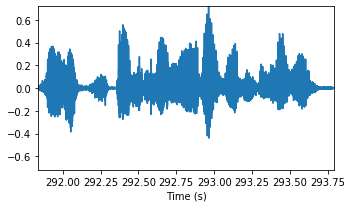

Speaker 0 (291.84s - 293.7899375s)


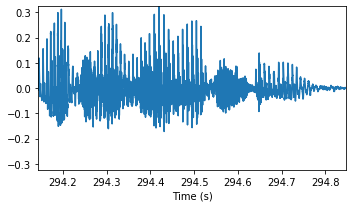

Speaker 0 (294.144s - 294.8459375s)


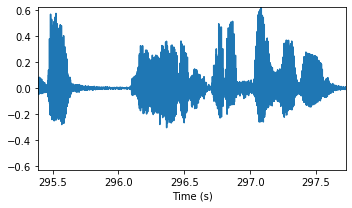

Speaker 0 (295.392s - 297.7259375s)


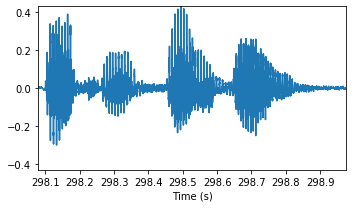

Speaker 0 (298.08s - 298.9739375s)


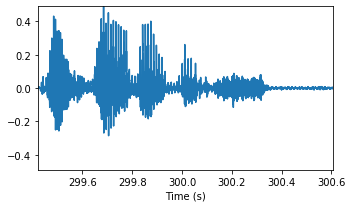

Speaker 0 (299.424s - 300.6059375s)


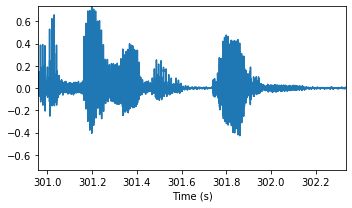

Speaker 0 (300.96s - 302.3339375s)


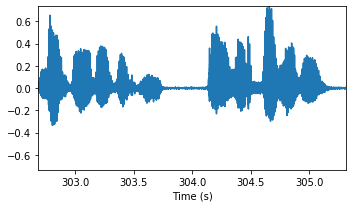

Speaker 0 (302.688s - 305.3099375s)


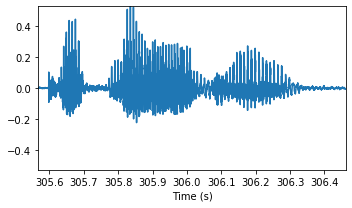

Speaker 0 (305.568s - 306.4619375s)


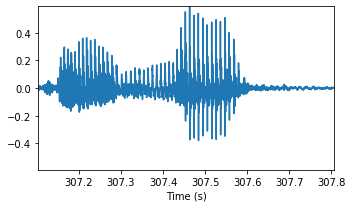

Speaker 0 (307.104s - 307.8059375s)


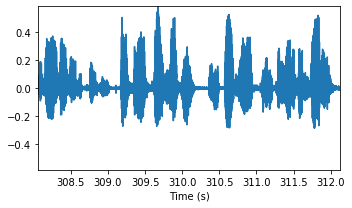

Speaker 0 (308.064s - 312.1259375s)


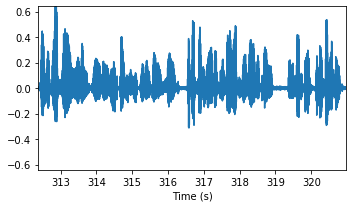

Speaker 0 (312.384s - 320.9579375s)


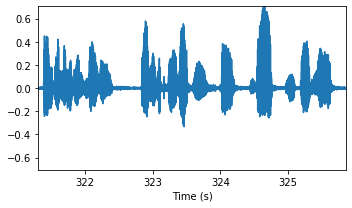

Speaker 0 (321.312s - 325.8539375s)


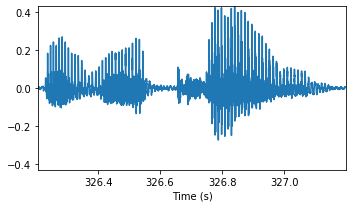

Speaker 0 (326.208s - 327.1979375s)


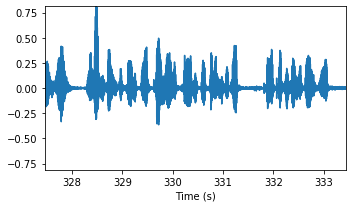

Speaker 0 (327.456s - 333.4379375s)


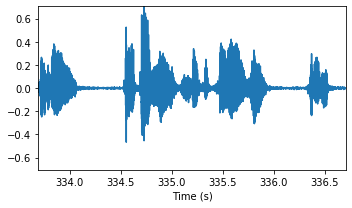

Speaker 0 (333.696s - 336.7019375s)


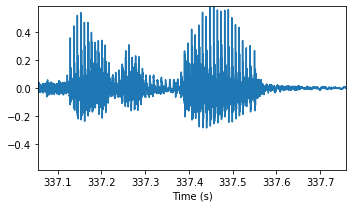

Speaker 0 (337.056s - 337.7579375s)


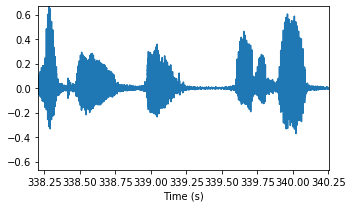

Speaker 0 (338.208s - 340.2539375s)


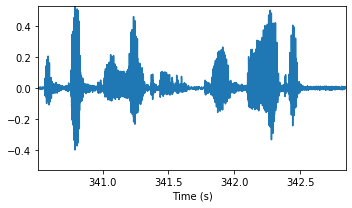

Speaker 0 (340.512s - 342.8459375s)


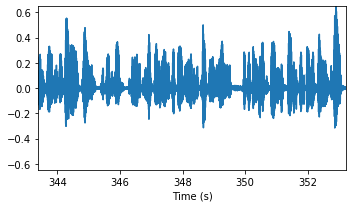

Speaker 0 (343.392s - 353.2139375s)


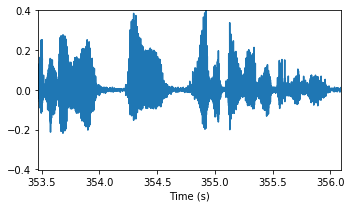

Speaker 0 (353.472s - 356.0939375s)


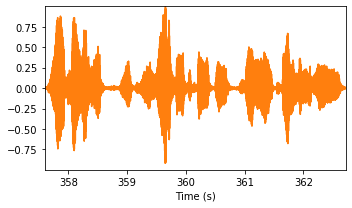

Speaker 1 (357.6s - 362.7179375s)


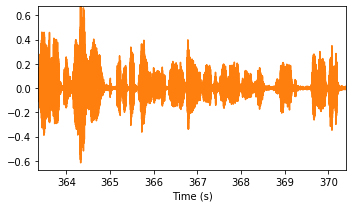

Speaker 1 (363.36s - 370.3979375s)


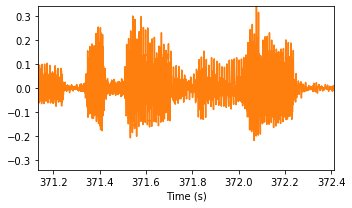

Speaker 1 (371.136s - 372.4139375s)


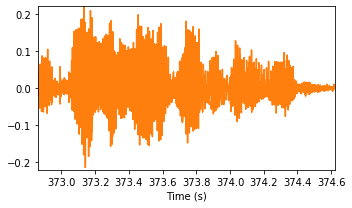

Speaker 1 (372.864s - 374.6219375s)


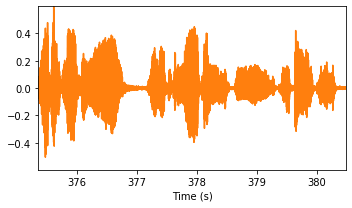

Speaker 1 (375.36s - 380.4779375s)


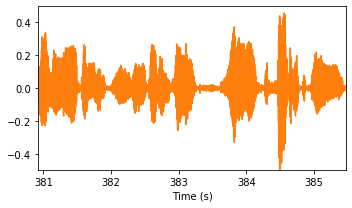

Speaker 1 (380.928s - 385.4699375s)


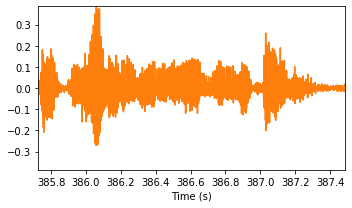

Speaker 1 (385.728s - 387.4859375s)


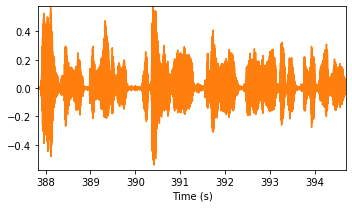

Speaker 1 (387.84s - 394.6859375s)


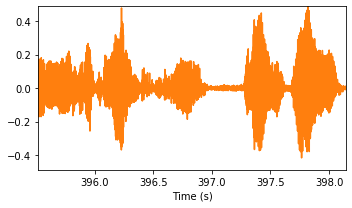

Speaker 1 (395.52s - 398.1419375s)


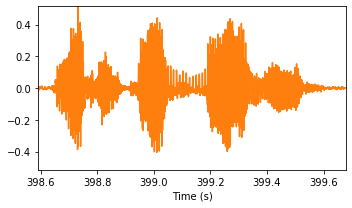

Speaker 1 (398.592s - 399.6779375s)


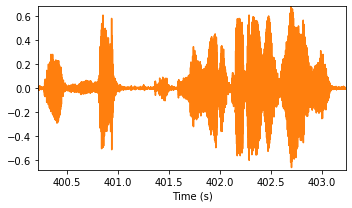

Speaker 1 (400.224s - 403.2299375s)


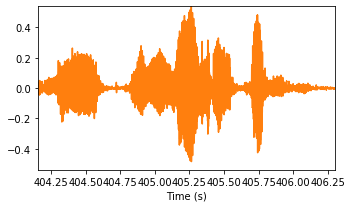

Speaker 1 (404.16s - 406.3019375s)


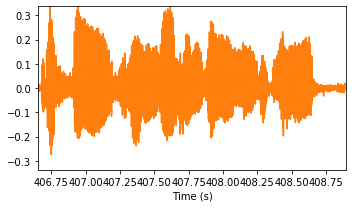

Speaker 1 (406.656s - 408.8939375s)


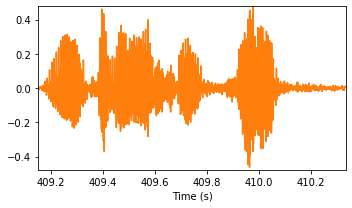

Speaker 1 (409.152s - 410.3339375s)


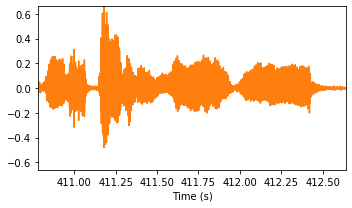

Speaker 1 (410.784s - 412.6379375s)


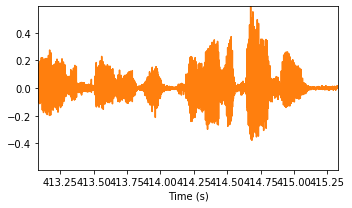

Speaker 1 (413.088s - 415.3259375s)


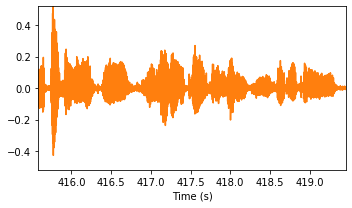

Speaker 1 (415.584s - 419.4539375s)


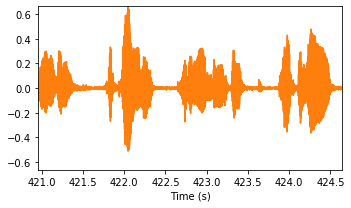

Speaker 1 (420.96s - 424.6379375s)


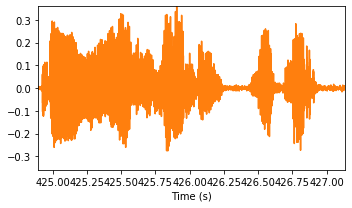

Speaker 1 (424.896s - 427.1339375s)


In [ ]:
waveplot_perspeaker(signal, fs, segments)

# (YouTube Only) Matching Diarization with ASR Transcript

## Here, the diarization output can be matched with the segments from the auto-transcription

In [ ]:
!youtube-dl --write-auto-sub --sub-lang en --sub-format ttml --skip-download -o "%(id)s.%(ext)s" $YOUTUBE_ID
text_segments = parse_ttml('./{}.en.ttml'.format(YOUTUBE_ID))

[youtube] I49VNQ6lmKk: Downloading webpage
[info] Writing video subtitles to: I49VNQ6lmKk.en.ttml


Let's look at a sample segment from these auto-generated transcriptions

In [ ]:
example_text_seg = text_segments[150]
print(example_text_seg)
start_idx = int(example_text_seg['start']*fs)
end_idx = int(example_text_seg['end']*fs)
Audio(signal[start_idx:end_idx], rate=fs)

{'start': 305.44, 'end': 309.12, 'text': 'technology'}


As we can see from this example the alignment is not necessarily that great (quite a few extra words in this segment compared to what the alignment indicates) so  our output may be messy

In [ ]:
yt_worded_segments = diar.match_diarization_to_transcript(segments, text_segments)

In [ ]:
pprint(yt_worded_segments)

[{'end': 7.3259375,
  'end_sample': 117215,
  'label': 0,
  'start': 0.24,
  'start_sample': 5664,
  'words': "hey what's up mkbhd here so as you may"},
 {'end': 8.5739375,
  'end_sample': 137183,
  'label': 0,
  'start': 7.584,
  'start_sample': 121344,
  'words': 'have seen'},
 {'end': 11.6459375,
  'end_sample': 186335,
  'label': 0,
  'start': 9.12,
  'start_sample': 145920,
  'words': "barack obama's been on a pretty massive book tour for his new "
           'book'},
 {'end': 13.4699375,
  'end_sample': 215519,
  'label': 0,
  'start': 11.904,
  'start_sample': 190464,
  'words': ''},
 {'end': 15.1019375,
  'end_sample': 241631,
  'label': 0,
  'start': 13.824,
  'start_sample': 221184,
  'words': "a promised land uh it's been a pretty"},
 {'end': 17.0219375,
  'end_sample': 272351,
  'label': 0,
  'start': 15.36,
  'start_sample': 245760,
  'words': 'great read so far for me'},
 {'end': 20.6699375,
  'end_sample': 330719,
  'label': 0,
  'start': 17.376,
  'start_sample': 278016

In [ ]:
diar.nice_text_output(yt_worded_segments, './yt_test.txt')

In [ ]:
!head -n 50 yt_test.txt

[0.24 to 7.33] Speaker 0: 
hey what's up mkbhd here so as you may

[7.58 to 8.57] Speaker 0: 
have seen

[9.12 to 11.65] Speaker 0: 
barack obama's been on a pretty massive book tour for his new book

[11.9 to 13.47] Speaker 0: 


[13.82 to 15.1] Speaker 0: 
a promised land uh it's been a pretty

[15.36 to 17.02] Speaker 0: 
great read so far for me

[17.38 to 20.67] Speaker 0: 
but then youtube reached out and they're

[21.6 to 26.91] Speaker 0: 
like hey do you want to ask obama anything about what he talks about in this book and so of course i said yes that would be

[27.26 to 28.16] Speaker 0: 
awesome

[28.7 to 57.82] Speaker 0: 
but that's that's a big moment for me like what do i ask the president if i could ask him anything so anyway what i have for you are the two questions that i chose and this is actually part of a larger youtube originals project called booktube where he answers a bunch of questions from a bunch of other creators about that book and what he wants to talk ab

# Helper functions for diarizing YouTube

In [ ]:
diar = Diarizer(
                embed_model='ecapa', # supported types: ['xvec', 'ecapa']
                cluster_method='sc', # supported types: ['ahc', 'sc']
                window=1.5, # size of window to extract embeddings (in seconds)
                period=0.75 # hop of window (in seconds)
                )

Using cache found in /root/.cache/torch/hub/snakers4_silero-vad_master


## It's Always Sunny in Philadelphia (Pepe Silvia)


In [ ]:
iasip_video = "https://www.youtube.com/watch?v=ghrdSTC66MA"
HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/{}?rel=0&amp;controls=0&amp;showinfo=0" frameborder="0" allowfullscreen></iframe>'.format(get_youtube_id(iasip_video)))

In [ ]:
iasip_segments, iasip_worded_segments, iasip_wav = diar.diarize_youtube(iasip_video, 
                                                                        num_speakers=2,
                                                                        threshold=None, 
                                                                        overwrite=True, 
                                                                        outfolder='./pepe_silvia')

Downloaded audio and converted to: ./pepe_silvia/ghrdSTC66MA_converted.wav
Running VAD...
Splitting by silence found 22 utterances
Extracting embeddings...


Utterances:   0%|          | 0/22 [00:00<?, ?it/s]

Clustering to 2 speakers...
Cleaning up output...
Done!


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:234: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


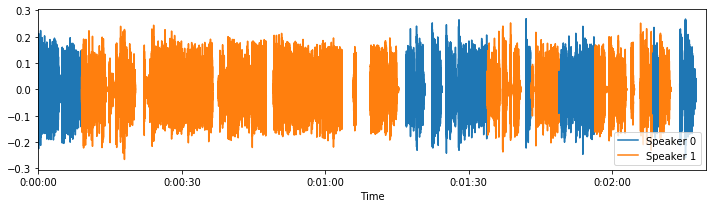

In [ ]:
signal, fs = sf.read(iasip_wav)
combined_waveplot(signal, fs, iasip_segments, tick_interval=30)
plt.show()

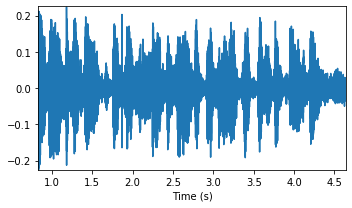

Speaker 0 (0.03s - 4.6379375s)
''


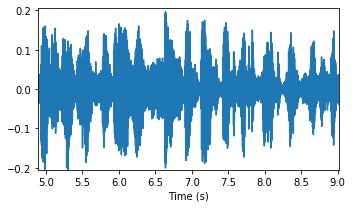

Speaker 0 (4.896s - 9.021s)
("they're onto me do those got your sharpest nails up there I can't put "
 "anything past them oh my god dude I'm")


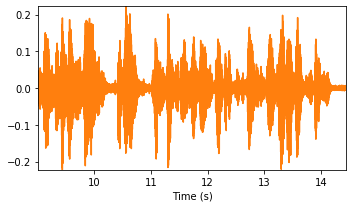

Speaker 1 (9.021s - 14.4299375s)
("freaking out I am so stressed out I feel like I'm having a panic attack you "
 'want to talk about stress about that much stress okay')


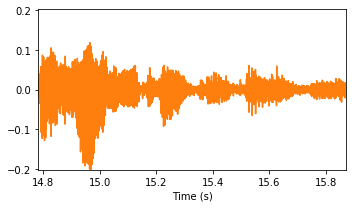

Speaker 1 (14.784s - 15.8699375s)
"I've stumbled onto a major company"


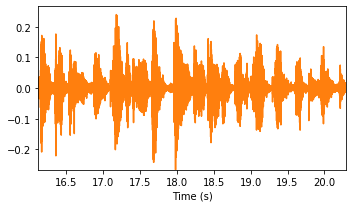

Speaker 1 (16.128s - 20.2859375s)
'conspiracy Mack how about that for stress the hell are you talking about'


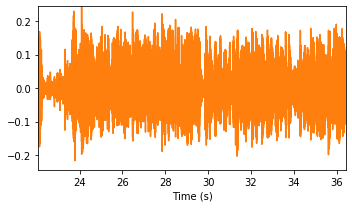

Speaker 1 (22.08s - 36.4139375s)
('this company is being bled like a stuck pig back and I got a paper trail to '
 'prove it check this out take a look at that geez Christ that right there is '
 "the mail now let's talk about the milk when we talk about the mail please "
 'Maccabee diner talk about the mail for you all day okay Pepe Silvia this '
 'name keeps coming up over and over again every day')


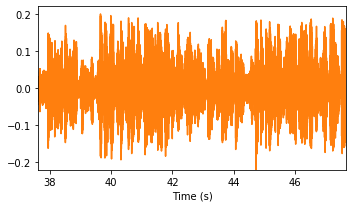

Speaker 1 (37.632s - 47.6459375s)
('Pepe smells getting sent back to me Pepe Silvia Pepe Silvia I look in the '
 'milk with this whole boxes Pepe Silvia so I say to myself I gotta find this '
 "guy I gotta go up to his office I gotta put his mail in the guy's goddamn "
 "hands otherwise he's never gonna get he's")


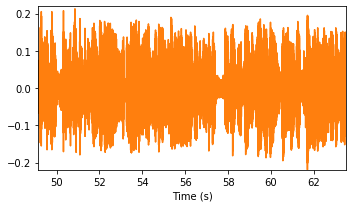

Speaker 1 (49.152s - 63.4859375s)
('gonna keep coming back down here so I got the peppers officer what do I find '
 'out man what do I find out can you stop Pepe Silvia the men does not exist '
 "ok so I decided oh [ __ ] buddy I gotta dig a little deeper there's no Pepe "
 'so you gotta be kidding me I got passion full')


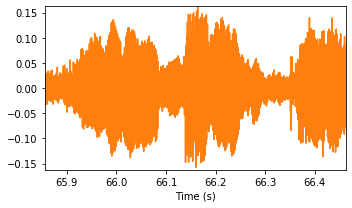

Speaker 1 (65.856s - 66.4619375s)
'of Pepe alright so I start marching my'


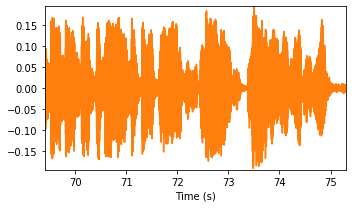

Speaker 1 (69.408s - 75.2939375s)
('way down to Carol Ann HR and I knock on a door and I say Carol Carol I gotta '
 'talk to you about that pea when I open')


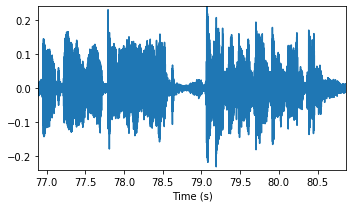

Speaker 0 (76.896s - 80.8619375s)
"the door what do I find there's not a single goddamn desk in that office there"


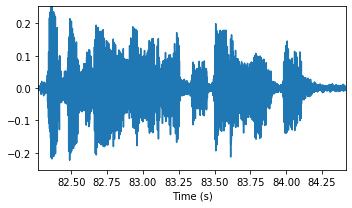

Speaker 0 (82.272s - 84.4139375s)
'is no Carol in HR Mac half the employees in this building and it made up this'


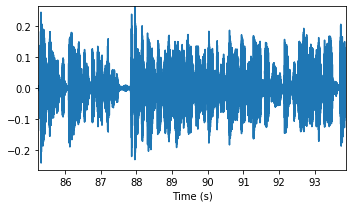

Speaker 0 (85.248s - 93.873s)
("office is a goddamn ghost town okay Charlie I'm gonna have to stop you right "
 "there not only do all of these people exist but they've been asking for "
 "their mail on a daily basis it's all")


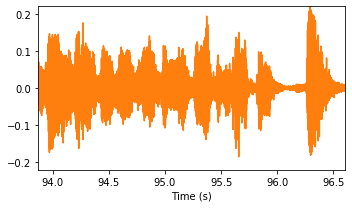

Speaker 1 (93.873s - 96.6059375s)
"they're talking about out there Jesus"


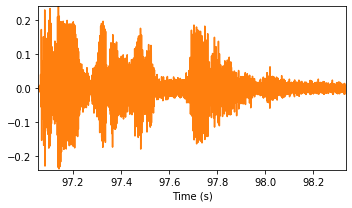

Speaker 1 (97.056s - 98.3339375s)
"Christ dude we're gonna lose our jobs well calm down cuz here's one thing"


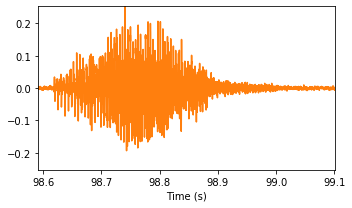

Speaker 1 (98.592s - 99.1019375s)
''


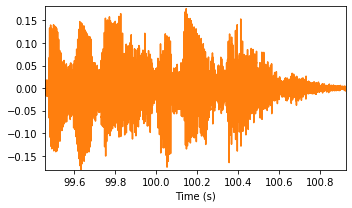

Speaker 1 (99.456s - 100.9259375s)
''


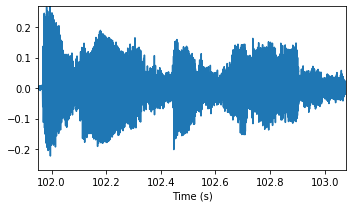

Speaker 0 (101.952s - 103.077s)
"that's not gonna happen what we're not"


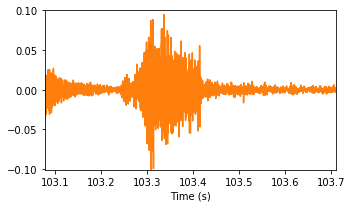

Speaker 1 (103.077s - 103.7099375s)
''


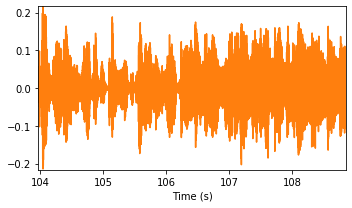

Speaker 1 (103.968s - 108.843s)
("gonna get fired we're not cuz we've already been fired we've lost our jobs "
 'yeah about three')


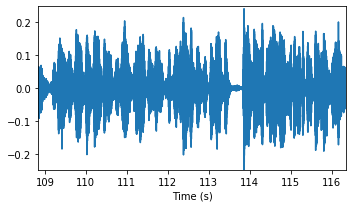

Speaker 0 (108.843s - 116.343s)
('days ago a couple pink slips came in the mail one for you one for me so what '
 "did I do I mailed them halfway to Siberia oK we've lost our jobs that means "
 "we've lost our health insurance which means")


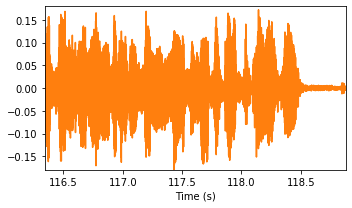

Speaker 1 (116.343s - 118.8779375s)
'all of this was for nothing god dammit dude I am having a panic'


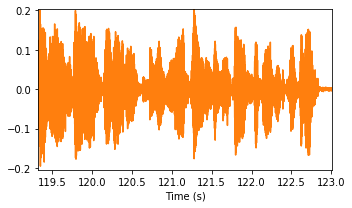

Speaker 1 (119.328s - 123.0059375s)
("attack I'm actually having a probably a settle down have another cup of "
 'coffee I')


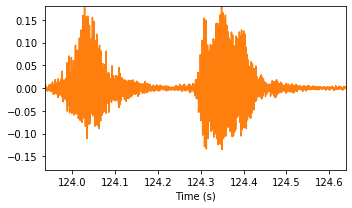

Speaker 1 (123.936s - 124.6379375s)
''


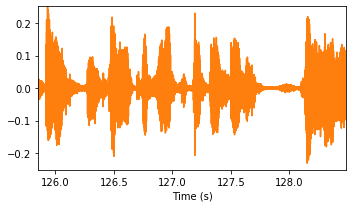

Speaker 1 (125.856s - 128.481s)
"am bro all right well it's fine you know what Barney give this guy a cigarette"


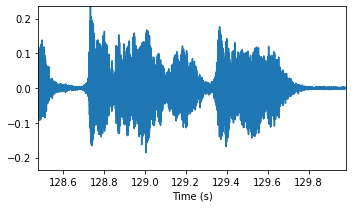

Speaker 0 (128.481s - 129.981s)
''


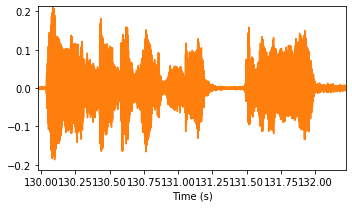

Speaker 1 (129.981s - 132.2219375s)
"he's freaking out huh Barney he's the"


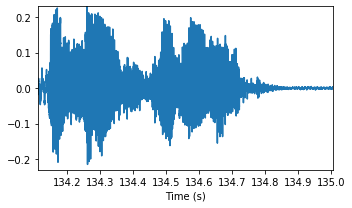

Speaker 0 (134.112s - 135.0059375s)
'guy who tipped me off to Pepe Silvia'


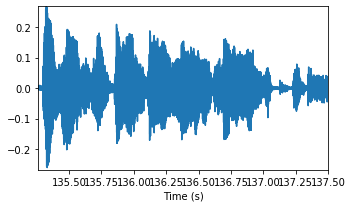

Speaker 0 (135.264s - 137.5019375s)
("Barney who the hell is Barney you see my old [ __ ] what the hell Hey you've "
 "lost your mind you've lost your goddamn mind charlie")


In [ ]:
waveplot_perspeaker(signal, fs, iasip_worded_segments)

Scrolling through the snippets the speaker segments are isolated correctly but the transcripts are not aligned well

## 5 Person Interview

In [ ]:
outih_video = "https://youtu.be/h_W12HmsIMY"
HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/{}?rel=0&amp;controls=0&amp;showinfo=0" frameborder="0" allowfullscreen></iframe>'.format(get_youtube_id(outih_video)))

In [ ]:
outih_segments, outih_worded_segments, outih_wav = diar.diarize_youtube(outih_video, 
                                                                        num_speakers=5, 
                                                                        overwrite=True, 
                                                                        outfolder='./outih')

Downloaded audio and converted to: ./outih/h_W12HmsIMY_converted.wav
Running VAD...
Splitting by silence found 150 utterances
Extracting embeddings...


Utterances:   0%|          | 0/150 [00:00<?, ?it/s]

Clustering to 5 speakers...


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:234: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


Cleaning up output...
Done!


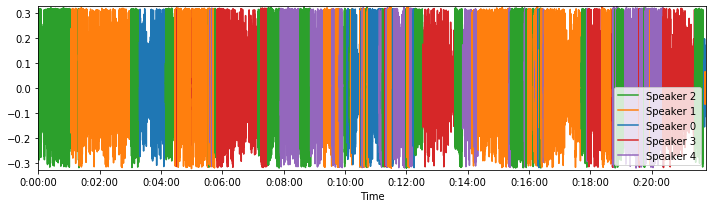

In [ ]:
signal, fs = sf.read(outih_wav)
combined_waveplot(signal, fs, outih_segments, tick_interval=120)
plt.show()

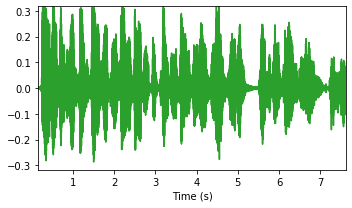

Speaker 2 (0.03s - 7.6139375s)


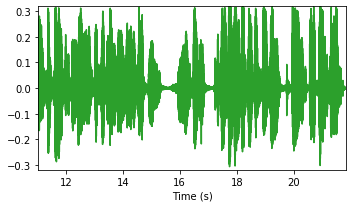

Speaker 2 (11.04s - 21.8219375s)


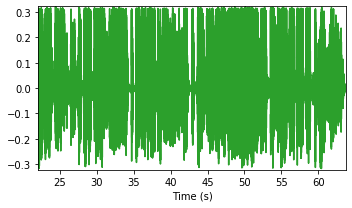

Speaker 2 (22.08s - 63.705s)


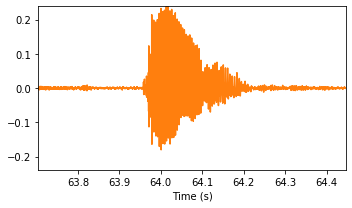

Speaker 1 (63.705s - 64.4459375s)


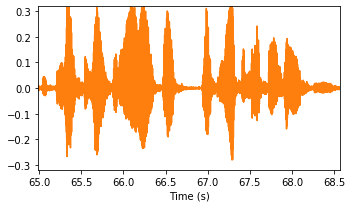

Speaker 1 (64.992s - 68.5739375s)


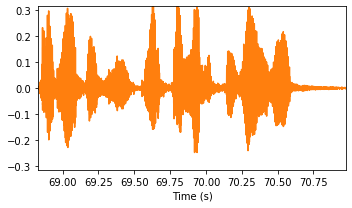

Speaker 1 (68.832s - 70.9739375s)


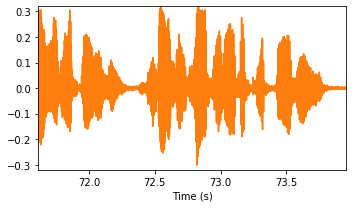

Speaker 1 (71.616s - 73.9499375s)


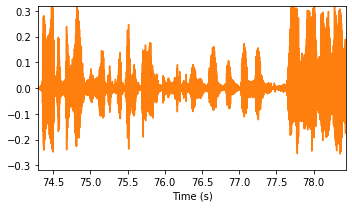

Speaker 1 (74.304s - 78.429s)


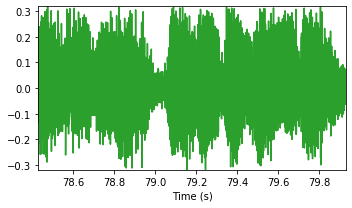

Speaker 2 (78.429s - 79.929s)


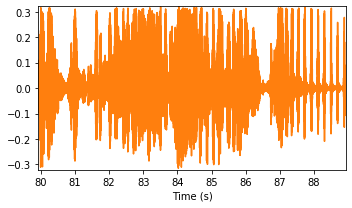

Speaker 1 (79.929s - 88.9259375s)


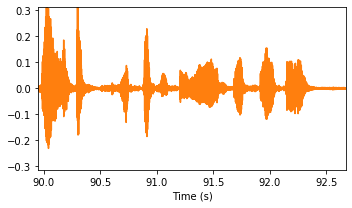

Speaker 1 (89.952s - 92.6699375s)


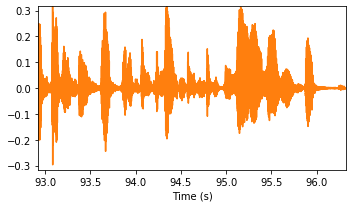

Speaker 1 (92.928s - 96.3179375s)


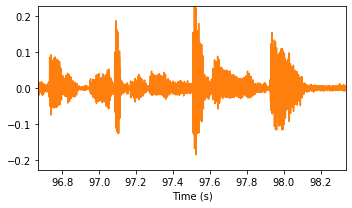

Speaker 1 (96.672s - 98.3339375s)


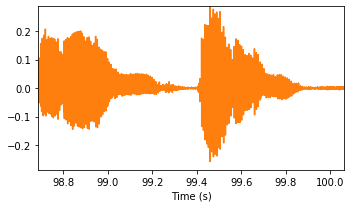

Speaker 1 (98.688s - 100.0619375s)


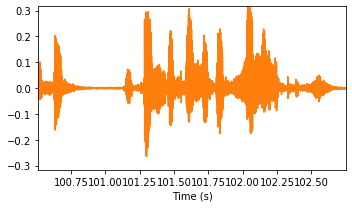

Speaker 1 (100.512s - 102.7499375s)


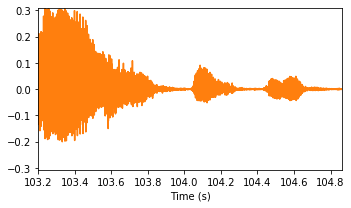

Speaker 1 (103.2s - 104.8619375s)


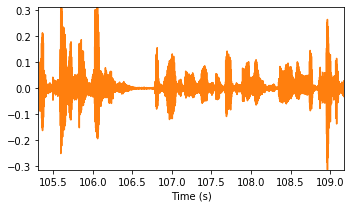

Speaker 1 (105.312s - 109.1819375s)


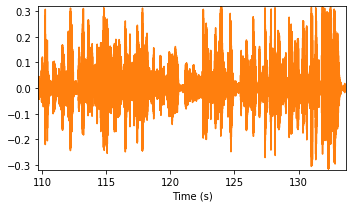

Speaker 1 (109.728s - 133.6619375s)


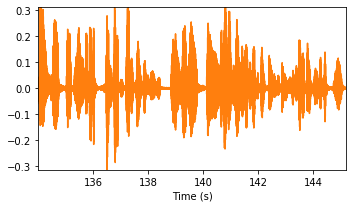

Speaker 1 (134.016s - 145.1819375s)


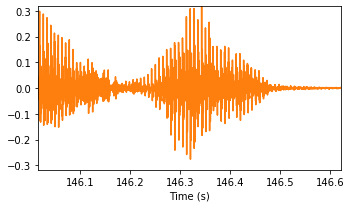

Speaker 1 (146.016s - 146.6219375s)


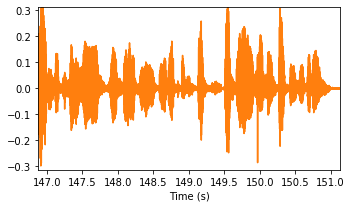

Speaker 1 (146.88s - 151.1339375s)


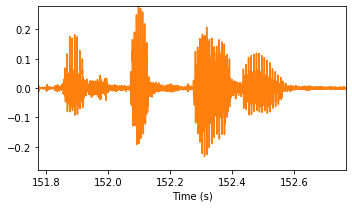

Speaker 1 (151.776s - 152.7659375s)


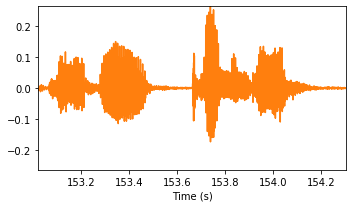

Speaker 1 (153.024s - 154.3019375s)


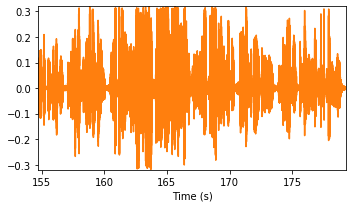

Speaker 1 (154.752s - 179.2619375s)


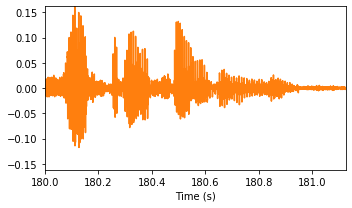

Speaker 1 (180.0s - 181.125s)


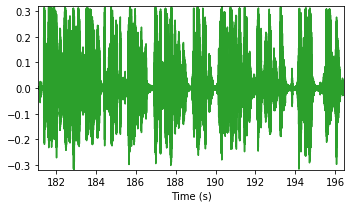

Speaker 2 (181.125s - 196.4459375s)


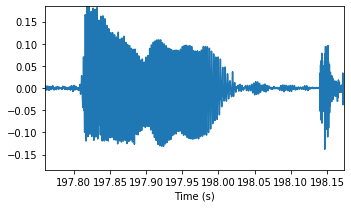

Speaker 0 (197.76s - 198.1739375s)


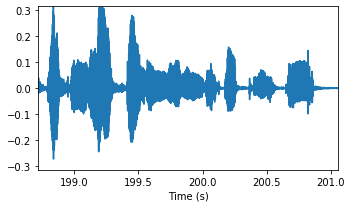

Speaker 0 (198.72s - 201.0539375s)


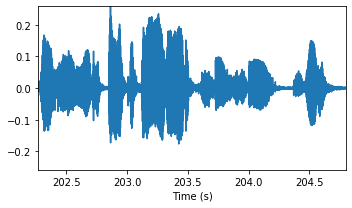

Speaker 0 (202.272s - 204.7979375s)


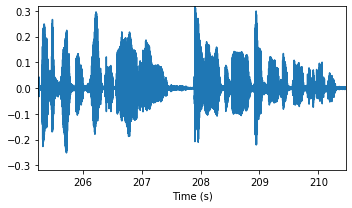

Speaker 0 (205.248s - 210.4619375s)


In [ ]:
waveplot_perspeaker(signal, fs, outih_segments[:30])